In [1]:
from numpy import round,genfromtxt
import matplotlib.pyplot as plt
import pandas as pd

In [2]:
# Load .iges (Lines_from_iges)
def Lines_from_iges(file,cifras):

  import numpy as np
  vertex=[]
  lines_coord=[]
  lines=[]

  f = open(file)
  text = f.readlines()
  for i in range(len(text)):
    line=text[i]
    if line[72] == "P" and line[:3]=="110":
      ident = line[66:72]
      data = line[3:64]
      next_line=text[i+1]

      if next_line[66:72] == ident:
        data = data + next_line[0:64]

      data = data.replace(";",",")
      data = data.replace(","," ")

      param = data.split()
      param = [round(float(item),cifras) for item in param]
      vertex.append(param[0:3])
      vertex.append(param[3:6])
      lines_coord.append([param[0:3],param[3:6]])

  vertex = np.array(vertex)
  vertex = np.unique(vertex,axis=0)
  vertex = [list(node) for node in vertex ]

  for line in lines_coord:
    index_1 = vertex.index(line[0])
    index_2 = vertex.index(line[1])
    lines.append([index_1,index_2])

  vertex = np.array(vertex)
  lines = np.array(lines)
  f.close()
  return vertex, lines

In [3]:
# Unit System
# Base Units
m = 1
kg = 1
s = 1
# Other Units
mm = 0.001*m
cm = 0.01*m
N = kg*m/s**2
kgf = 9.81*N
tonf = 1000*kgf
ton= 1000*kg
Pa = N/m**2
MPa = 10**6*Pa
inch = 2.54*cm
ft = 12*inch
ksi = 6894757.2932*Pa
kip = ksi*inch**2
psi = 6894.76*Pa
# Constants
g = 9.81*m/s**2

In [16]:
# Structural Analysis of 3D bar elements
from numpy import zeros, array, hstack, identity, pi, sqrt, arange, setdiff1d, cumsum, where, delete
from scipy.linalg import eigh, cholesky
from numpy.linalg import inv, norm
import matplotlib.pyplot as plt
import pandas as pd

def Assemble_K_element(coord_start,coord_end,E,A,ρ):
  ΔV = coord_end-coord_start
  L = norm(ΔV)
  Cx = ΔV[0]/L
  Cy = ΔV[1]/L
  Cz = ΔV[2]/L
  Ke = zeros((6,6))
  RotX = array([[1]])
  λ = array([[Cx*Cx, Cx*Cy, Cx*Cz],
             [Cy*Cx, Cy*Cy, Cy*Cz],
             [Cz*Cx, Cz*Cy, Cz*Cz]])
  Ke[:3,:3] =  λ
  Ke[:3,3:] = -λ
  Ke[3:,:3] = -λ
  Ke[3:,3:] =  λ
  Ke = Ke*E*A/L
  Me = ρ*A*L/2*identity(6)
  return Ke, Me

def Assemble_KM_general(nodes,element,E,A,ρ):
  N = len(nodes)*3
  K = zeros((N,N))
  M = zeros((N,N))
  dof = array([[i*3,i*3+1,i*3+2] for i in range(len(nodes))])

  for start,end in element:
    coord_start = nodes[start]
    coord_end = nodes[end]
    Ke, Me = Assemble_K_element(coord_start,coord_end,E,A,ρ)
    dof_e = hstack((dof[start],dof[end]))
    for i in range(6):
      for j in range(6):
        a = dof_e[i]
        b = dof_e[j]
        K[a,b] = Ke[i,j] + K[a,b]
        M[a,b] = Me[i,j] + M[a,b]

  return K, M

def Assemble_F(M,gravity,self_weight=False):
  F = zeros((len(M),1))
  g_vector = array([0,0,-gravity]*int(len(M)/3))
  if self_weight==True:
    for i in range(len(M)):
      F[i] = M[i,i]
    F = F*g_vector.reshape(len(M),1)
  else:
    pass
  return F

def FixZ(K,F,nodes,z,constraint):
  id_node_z = array([i for i in range(len(nodes)) if nodes[i][2]==z ])
  for i in id_node_z:
    gl=array([i*3+1,i*3+2,i*3+3])*array(constraint)
    gl = gl[gl!=0]-1
    K[gl,:]  = 0.0
    K[gl,gl] = 1.0
    F[gl] = 0
  return K

def load(F,node,constraint, value):
  constraint = array(constraint)
  gl=array([node*3+1,node*3+2,node*3+3])*constraint
  gl = gl[gl!=0]-1
  F[gl] = F[gl] + constraint[constraint!=0].reshape((len(gl),1))*value
  return F

def gradient_conjugate(A,b):
  x = zeros(len(b))
  r = b-A@x
  p = r
  condition = r.T@r

  for i in range(10e4):
    Ap = A@p
    α = condition/(p.T@Ap)
    x = x + α*p
    r = r - α*Ap
    condition_new = r.T@r
    if sqrt(condition_new)<1e-10: break
    p = r + (condition_new/condition)*p
    condition = condition_new
  return x


def displacement(nodes,U,scale):
  displacement = U.reshape(len(nodes),3)
  deform = displacement + nodes
  deform_scale = displacement*scale + nodes
  return displacement, deform, deform_scale

def Modal_analysis(K,M):
  f,c = where(K==1)
  id = arange(len(M))
  dez_mode = zeros((len(M),(len(M)-len(c))))
  id_rows = setdiff1d(id,f)
  K = delete(K,f,axis=0)
  M = delete(M,f,axis=0)
  K = delete(K,c,axis=1)
  M = delete(M,c,axis=1)

  λ,ϕp = eigh(K,M)
  Tn = 2*pi/(λ**0.5)

  Ux,Uy,Uz = zeros(len(M)),zeros(len(M)),zeros(len(M))
  Ux[0::3]=1
  Uy[1::3]=1
  Uz[2::3]=1

  Mx = sum(sum(M[0::3,0::3]))
  My = sum(sum(M[1::3,1::3]))
  Mz = sum(sum(M[2::3,2::3]))

  FPx = ϕp.T@M@Ux
  FPy = ϕp.T@M@Uy
  FPz = ϕp.T@M@Uz
  FPMx = FPx**2/Mx
  FPMy = FPy**2/My
  FPMz = FPz**2/Mz
  SUMx = cumsum(FPMx)
  SUMy = cumsum(FPMy)
  SUMz = cumsum(FPMz)
  data = {'Modo':[i+1 for i in range(len(M))],
          'T(s)':Tn,'Ux':FPMx,'Uy':FPMy,'Uz':FPMz,
          'SumUx':SUMx,'SumUy':SUMy,'SumRz':SUMz}
  df = pd.DataFrame(data)

  for i, row in enumerate(id_rows):
    dez_mode[row] = ϕp[i]

  return df,dez_mode

def damping_rayleigh(K,M,t,ζ =0.05):
  α = ζ*2*pi/t
  β = ζ/2*pi/t
  C = α*M+β*K
  return C

def newmark(K,M,C,ug,Δt =0.02,d="x"):
  f,c = where(K==1)
  id = arange(len(M))
  dez_TH = zeros((len(M),len(ug)))
  id_rows = setdiff1d(id,f)
  K = delete(K,f,axis=0)
  M = delete(M,f,axis=0)
  C = delete(C,f,axis=0)

  K = delete(K,c,axis=1)
  M = delete(M,c,axis=1)
  C = delete(C,c,axis=1)

  ng = len(M)
  nt = len(ug)

  u = zeros((ng,nt))
  v = zeros((ng,nt))
  a = zeros((ng,nt))
  Mug = zeros((ng,nt))
  if d=="x":
    Mug[0::3,:] = ug
  elif d=="y":
    Mug[1::3,:] = ug
  P = -M@Mug

  γ , β = 1/2, 1/4

  a0 = 1/(β*Δt**2)
  a1 = γ/(β*Δt)
  a2 = 1/(β*Δt)
  a3 = (1/(2*β)-1)
  a4 = γ/β - 1
  a5 = Δt*(γ/(2*β) - 1)
  a6 = Δt*(1-γ)
  a7 = γ*Δt

  Kt = K + a0*M + a1*C
  Ki = inv(Kt)

  a[:,0]=inv(M)@(P[:,0]-K@u[:,0]-C@v[:,0])

  for i in range(nt-1):
    Pti = P[:,i+1] + M@(a0*u[:,i]+a2*v[:,i]+a3*a[:,i]) + C@(a1*u[:,i]+a4*v[:,i]+a5*a[:,i])
    u[:,i+1] = Ki@Pti

    a[:,i+1] = a0*(u[:,i+1]-u[:,i]) - a2*v[:,i] - a3*a[:,i]
    v[:,i+1] = v[:,i] + a6*a[:,i] + a7*a[:,i+1]

  for i in range(len(ug)):
    dez_TH[id_rows,i]= u[:,i]

  return dez_TH,u,v,a



def plot_structure(nodes,lines,deform_scale="",figsize=(20,20),az_el=None,node_labels=1,element_labels=0,backend="Matplotlib",node="",displacements="",unit="cm"):

  if backend == "Matplotlib":
    fig = plt.figure(figsize=figsize,dpi=480)
    ax = fig.add_subplot(projection='3d')
    if type(deform_scale)==str:
      ax.scatter(nodes[:,0],nodes[:,1],nodes[:,2],c="blue")
      if node_labels:
        for i,coord in enumerate(nodes):
          ax.text(coord[0],coord[1],coord[2],str(i), va='bottom', ha='left', color='blue')
      for i,(x,y) in enumerate(lines):
        ax.plot(nodes[[x,y],0],nodes[[x,y],1],nodes[[x,y],2],c="black")
        if element_labels:
          ax.text(sum(nodes[[x,y],0])/2+0.03, sum(nodes[[x,y],1])/2+0.03, sum(nodes[[x,y],2])/2+0.03, str(i), va='bottom', ha='left', color='red')
    else:
      for x,y in lines:
        ax.plot(nodes[[x,y],0],nodes[[x,y],1],nodes[[x,y],2],"g--")

      for x,y in lines:
        ax.plot(deform_scale[[x,y],0],deform_scale[[x,y],1],deform_scale[[x,y],2],"b.-")
      if type(node)==str:pass
      elif type(displacements)==str:pass
      else:
        ax.text(deform_scale[node][0],deform_scale[node][1],deform_scale[node][2]+1.5,s="Ux= "+str(round(displacements[node][0]/eval(unit),4))+" "+unit)
        ax.text(deform_scale[node][0],deform_scale[node][1],deform_scale[node][2]+1.0,s="Uy= "+str(round(displacements[node][1]/eval(unit),4))+" "+unit)
        ax.text(deform_scale[node][0],deform_scale[node][1],deform_scale[node][2]+0.5,s="Uz= "+str(round(displacements[node][2]/eval(unit),4))+" "+unit)
    if az_el == None:
      pass
    else:
      azim, elev = az_el
      ax.view_init(azim=azim, elev=elev)
    return fig,ax

  elif backend == "Plotly":
    import plotly.graph_objects as go
    fig = go.Figure()

    if type(deform_scale)==str:
      for i,(x,y) in enumerate(lines):
        fig.add_trace(go.Scatter3d(x=nodes[[x,y],0],y=nodes[[x,y],1],z=nodes[[x,y],2],mode ="lines",
                      line=dict(color='black',width=2)))
      fig.add_trace(go.Scatter3d(x=nodes[:,0],y=nodes[:,1],z=nodes[:,2],text=[str(i) for i in range(len(nodes))],mode ="markers + text",
                      marker=dict(size=4,color='blue')))

    else:
      for i,(x,y) in enumerate(lines):
        fig.add_trace(go.Scatter3d(x=nodes[[x,y],0],y=nodes[[x,y],1],z=nodes[[x,y],2],mode ="lines",
                      line=dict(color='green',width=2, dash="dash")))
      for i,(x,y) in enumerate(lines):
        fig.add_trace(go.Scatter3d(x=deform_scale[[x,y],0],y=deform_scale[[x,y],1],z=deform_scale[[x,y],2],mode ="markers + lines",
                      line=dict(color='black',width=3),marker=dict(size=4,color='blue')))
      if type(node)==str:pass
      elif type(displacements)==str:pass
      else:
        fig.update_layout(scene=dict(annotations=[
        dict(
            showarrow=False,
            x=deform_scale[node][0],
            y=deform_scale[node][1],
            z=deform_scale[node][2]+1.5,
            text="Ux= "+str(round(displacements[node][0]/eval(unit),4))+" "+unit,
            xanchor="left",
            opacity=1),
        dict(
            showarrow=False,
            x=deform_scale[node][0],
            y=deform_scale[node][1],
            z=deform_scale[node][2]+1,
            text="Uy= "+str(round(displacements[node][1]/eval(unit),4))+" "+unit,
            xanchor="left",
            opacity=1),
        dict(
            showarrow=False,
            x=deform_scale[node][0],
            y=deform_scale[node][1],
            z=deform_scale[node][2]+0.5,
            text="Uz= "+str(round(displacements[node][2]/eval(unit),4))+" "+unit,
            xanchor="left",
            opacity=1)]))

    fig.update_layout(
        width=1400,
        height=600,
        autosize=False,
        showlegend=False,
        margin=dict(l=0, r=0, t=0, b=0),
        scene = dict(
          xaxis = dict(showgrid=False),
          yaxis = dict(showgrid=False),
          zaxis = dict(showgrid=False))
        )

    return fig

In [6]:
file = "DOMO_3D.iges"
nodes,lines=Lines_from_iges(file,5)

In [7]:
fig=plot_structure(nodes,lines,az_el=(50., 25.),element_labels=0,figsize=(40,10),backend="Plotly")
fig.show()

In [8]:
E=2038901.9*kgf/cm**2
A=66.4515*cm**2
densidad = 7849.0474*kg/m**3
gravity = 9.81
K_inicial,M = Assemble_KM_general(nodes,lines,E,A,densidad)
F = Assemble_F(M,gravity,self_weight=0)
K = FixZ(K_inicial,F,nodes,0,[1,1,1])
F = load(F,40,[1,0,0], -2000*kgf)
U = gradient_conjugate(K,F.flatten())

displacements, deform, deform_scale = displacement(nodes,U,scale=100000)

In [10]:
fig=plot_structure(nodes,lines,deform_scale=deform_scale,figsize=(20,10),backend="Plotly",node=40,displacements=displacements)
fig.show()

In [11]:
dataframe,dez_modes = Modal_analysis(K,M)
dataframe = dataframe.round(4)
dataframe

,Modo,T(s),Ux,Uy,Uz,SumUx,SumUy,SumRz
0,1,0.3307,0.0,0.0,0.0,0.0,0.0,0.0
1,2,0.3307,0.0,0.0,0.0,0.0,0.0,0.0
2,3,0.3273,0.0,0.0,0.0,0.0,0.0,0.0
3,4,0.3273,0.0,0.0,0.0,0.0,0.0,0.0
4,5,0.3145,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...
190,191,0.0026,0.0,0.0,0.0,1.0,1.0,1.0
191,192,0.0026,0.0,0.0,0.0,1.0,1.0,1.0
192,193,0.0025,0.0,0.0,0.0,1.0,1.0,1.0
193,194,0.0025,0.0,0.0,0.0,1.0,1.0,1.0


In [12]:
displacements2, deform, deform_scale = displacement(nodes,dez_modes.T[0],scale=200)
fig=plot_structure(nodes,lines,deform_scale=deform_scale,figsize=(20,10),backend="Plotly")
fig.update_layout(scene=dict(annotations=[
        dict(
            showarrow=False,
            x=0,
            y=0,
            z=20,
            text="T= "+str(round(dataframe['T(s)'][0],4))+" s",
            xanchor="left",
            opacity=1)]))
fig.show()

In [13]:
C = damping_rayleigh(K,M,0.3307)

r1 = genfromtxt("registro.txt",skip_header = 37,encoding='latin')
t = r1[:,0]
ug = r1[:,1]/100
dez_TH,u,v,a = newmark(K,M,C,ug)

In [14]:
deform_scales = []
for i in range(len(ug)):
  displacements2, deform, deform_scale = displacement(nodes,dez_TH.T[i],scale=300000)
  deform_scales.append(deform_scale)

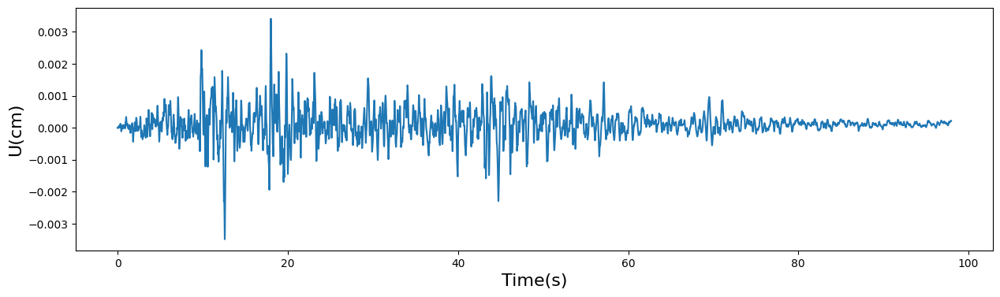

In [15]:
f1 = plt.figure( figsize = (15,4))
ax = f1.add_subplot()
ax.plot(t,dez_TH[24]/cm)
plt.xlabel('Time(s)', size = 16)
plt.ylabel('U(cm)', size = 16)
plt.show()

In [ ]:
import plotly.graph_objects as go
def frame_args(duration):
    return {
            "frame": {"duration": duration},
            "mode": "immediate",
            "fromcurrent": True,
            "transition": {"duration": duration, "easing": "linear"},
        }
fig = go.Figure(

    frames=[go.Frame(
        data=[go.Scatter3d(
            x=deform_scale[[x,y],0],
            y=deform_scale[[x,y],1],
            z=deform_scale[[x,y],2],
            mode ="markers + lines",
            line=dict(color='black',width=3),
            marker=dict(size=4,color='blue'))
         for (x,y) in lines] )for deform_scale in deform_scales[:400]])


for i,(x,y) in enumerate(lines):
  fig.add_trace(go.Scatter3d(x=nodes[[x,y],0],y=nodes[[x,y],1],z=nodes[[x,y],2],mode ="markers + lines",
                      line=dict(color='black',width=3),marker=dict(size=4,color='blue')))
fig.update_layout(
    updatemenus=[dict(type="buttons",buttons=[dict(label="Play",
                                                   method="animate",
                                                   args=[None, frame_args(1)]),
                                              dict(label="&#9724;",
                                                   method="animate",
                                                   args=[[None], frame_args(0)])
                                              ])])
fig.update_layout(
        width=1400,
        height=600,
        autosize=False,
        showlegend=False,
        margin=dict(l=0, r=0, t=0, b=0),
        scene = dict(
          xaxis = dict(showgrid=False),
          yaxis = dict(showgrid=False),
          zaxis = dict(showgrid=False))
        )

fig.show()

In [ ]:
fig.write_html("file.html")